In [2]:
%load_ext autoreload
%autoreload 2
import numpy as np
import matplotlib.pylab as plt
import matplotlib.colors as colors
import matplotlib.patches as patches
import torchvision
import matplotlib.patches as patches
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D

import os
import time
import torch
import sys
import argparse
sys.path.insert(0, '../code')
from model_loader_func import * 
from dataloader_func import *
from quality_metrics_func import *
from linear_approx import *
from plotting_func import *
from algorithm_inv_prob import * 
from trainer import make_loader
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
print(torch.__version__)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
device

2.5.0+cu124


device(type='cuda')

# functions 

In [4]:
## plotting stuff: 
noise_colormap = plt.cm.copper 
scale_colormap = plt.cm.seismic


In [5]:
similarity_matrix = lambda data : data/data.norm(dim = 1, keepdim=True) @(data/data.norm(dim = 1, keepdim=True)).T

degree_matrix = lambda sim_mat : torch.diag(sim_mat.sum(dim = 1))

participation_ratio = lambda v :  (v.norm(1)**2)/v.norm(2)**2/len(v)
participation_ratio_dataset = lambda data :  (data.norm(1, dim = 1)**2)/data.norm(2,dim = 1)**2/data.shape[1]


# Load denoisers 

In [6]:
denoisers = {}

root_path = '/mnt/home/zkadkhodaie/ceph/22_representation_in_UNet_denoiser/denoisers/'

paths = { 

         'mixture-color-no-skip-deep-enc-84':'UNet_flex/texture_EPS_color/0to255_RF_84x84_set_size_237580_color_no_skip_deep_enc_80x80/', 
        
        }

groups = paths.keys()


for group in groups: 
    path = root_path + paths[group]

    print('loading group ' , group )
    if 'modified' in group.split('-'):
        new_arch = 'UNet_conditional_mean_matching'
    else: 
        new_arch = None

    denoisers[group] = load_learned_model(path, print_args=True, new_arch=new_arch)
    start_time_total = time.time()        
    print("--- %s seconds ---" % (round(time.time() - start_time_total)))
 

loading group  mixture-color-no-skip-deep-enc-84
*************** saved arguments:*************
arch_name UNet_flex
lr 0.001
batch_size 512
num_epochs 1000
lr_freq 100
loss_weight False
noise_level_range [0, 255]
quadratic_noise True
rescale False
swap False
set_size 237580
imagenet_subset_ids None
data_name texture_EPS_color
data_root_path /mnt/home/zkadkhodaie/ceph/datasets/
dir_name /mnt/home/zkadkhodaie/ceph/21_hierarchical_conditional_prior/denoisers/UNet_flex/texture_EPS_color/0to255_RF_84x84_set_size_237580_color_no_skip_deep_enc_80x80
optional_dir_label color_no_skip_deep_enc
device cuda
debug False
kernel_size 3
padding 1
skip False
num_channels 3
bias True
RF 84
coarse True
self_cond False
num_kernels [64, 128, 256, 512]
num_blocks 3
num_enc_conv [2, 2, 2]
num_mid_conv 3
num_dec_conv [5, 6, 7]
NormType LayerNorm
inter_skip True
dilations None
data_path /mnt/home/zkadkhodaie/ceph/datasets/texture_EPS
******************************************************
number of parameters is

In [10]:
denoisers.keys()

dict_keys(['mixture-color-no-skip-deep-enc-84'])

In [11]:
layers = {}
for group in groups:
    layers[group] = []
    for i in range(len(denoisers[group].encoder)):
        layers[group].append(denoisers[group].encoder[str(i) ][0].weight.shape[0])
    
    layers[group].append(denoisers[group].mid[0].weight.shape[0])
    
    for i in range(len(denoisers[group].decoder)-1 , 0, -1):
        layers[group].append(denoisers[group].decoder[str(i) ][0].weight.shape[0])


layers

{'mixture-color-no-skip-deep-enc-84': [64, 128, 256, 512, 256, 128]}

In [12]:
block_names = {}
for group in groups: 
    block_names[group] = []
    for l in range(int(len(layers[group])/2)): 
        block_names[group].append('enc' + str(l))
    block_names[group].append('mid'  )        
    for l in range(int(len(layers[group])/2)-1, 0,-1):
        block_names[group].append('dec' + str(l) )
block_names  

{'mixture-color-no-skip-deep-enc-84': ['enc0',
  'enc1',
  'enc2',
  'mid',
  'dec2',
  'dec1']}

# Load datasets 

In [13]:
time0 = time.time()
### color images
# ### for 80x80 patches
data = torch.load(  '/mnt/home/zkadkhodaie/ceph/datasets/texture_EPS/patched_1024x1024_to_80x80_all_sets_color.pt',weights_only=True)
n_patches = int(1024/80)**2 # 144

num_classes = int(data.shape[0]/n_patches) # for 80x80: 882 + 786 #for 128x128:786

##### list of tensors. Each tensor contains images from same class 
train_sets = []
test_sets = []


for d in range(num_classes): 
    train_sets.append(data[n_patches * d: (n_patches * (d+1)) -4 ])
    test_sets.append(data[(n_patches * (d+1)) -4 : (n_patches * (d+1)) ] ) # in each image, leave the last 4 patches for test set       




print(f"loading time: {time.time() - time0} seconds ")

loading time: 5.099184274673462 seconds 


In [14]:
print('number of images in each class:', test_sets[0].shape)
K = test_sets[0].shape[2]
n_channels = test_sets[0].shape[1]
print(len(test_sets))

number of images in each class: torch.Size([4, 3, 80, 80])
1697


tensor(0.4016)


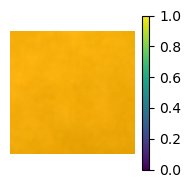

In [15]:
dist_mean = torch.concatenate(test_sets).mean(dim = (0))
plot_single_im(dist_mean, colorbar=True)
print(dist_mean.mean())

In [16]:
dist_mean.mean(dim = (1,2), keepdim = True)

tensor([[[0.4759]],

        [[0.4240]],

        [[0.3049]]])

In [17]:
test_sets_cat = torch.concatenate(test_sets)
test_sets_cat.shape

torch.Size([6788, 3, 80, 80])

In [18]:
train_sets_cat = torch.concatenate(train_sets)
train_sets_cat.shape

torch.Size([237580, 3, 80, 80])

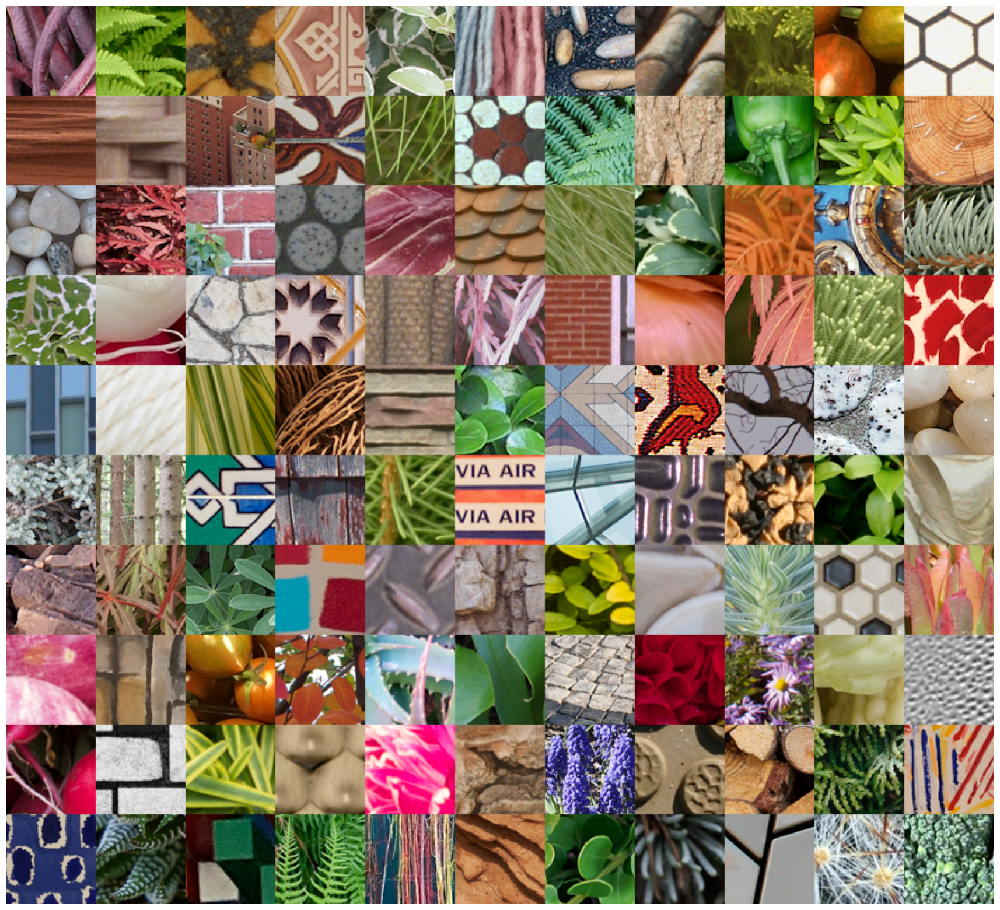

In [19]:
my_ids =  [4,7, 14,16, 20,24, 37, 41,67, 74, 96, 110, 121, 132, 144,151, 192, 199, 200,
                      233,246,248, 260, 271,343, 345, 350, 366, 374, 413, 415, 416, 439, 457, 
                     460, 492,516,520, 526,560, 597,617, 626,628, 629, 638,652,659, 665,682,
                     691, 697, 722,733,735,742, 753,754, 763, 764, 765, 778, 786, 802,805, 806, 814, 817,828, 
                     831, 843, 846,869,872, 902, 934,937,940,946, 974,977, 970,983, 1000 , 1015, 1040,1069,
                     1073,1077,1109, 1150, 1181,1193, 1261, 1298, 1321, 1412, 1415, 1455,1461,1464,1478, 1518,1532, 
                    1551,1577,1590, 1629, 1680, 1681]

my_ims =torch.concatenate([train_sets[id][77:78] for id in my_ids])
# show_im_set(my_ims, n_columns=11, sub_labels = my_ids)
show_im_grid(my_ims, n_columns=11)



$\phi(y)$ or the mean of the channel is a function of noise realization, noise level, and input image. 

- **noise realization**: We take the average of $\phi(y)$ at a noise level, for one image to remove the effect of noise realization. 

- **noise level**: We observe that the $\phi(y_{\sigma})$ and $\phi(y_{\sigma})$ at two different noise levels are highly related: first, active channels are mostly shared at different noise levels. Specially at intermediate and larger noise levels. There are more active channels at high noise levels and they include active channels at smaller noise levels. Second, they are highly correlated. That means they are aligned and differ by a poitive scalre value.

- **input image $x$**: after getting rid of noise effect, we can look at how $\phi(y)$ changes from image to image. We can interpret $\phi(y)$ as a good approximation of $\phi(x)$. Now we ask if  Euclidean distance in latent space $\Vert \phi(x_1) -  \phi(x_2) \Vert_2$ is meaningfully related to $\mathcal{D}(x_1, x_2)$ where $\mathcal{D}$ is a some distance metric between the two images. Since $\phi(x)$ is a many to one mapping, we can define a distance between the density of all images mapping to $\phi(x_1)$ and the density of all images mapping to $\phi(x_2)$, that is $\mathcal{D}( p(x|\phi(x_1), p(x|\phi(x_2)) )$. 

In [20]:
a_bars = {}
a_bars[group] = torch.load('../results/a_bar_noise_ave_mixture-color-no-skip-deep_texture80x80.pt', weights_only=True)
# phis_noise_ave_all_scales_80x80_mixture-color-no-skip-deep_texture.pt'


In [21]:
sigmas = list(a_bars[group].keys())
if sigmas[-1] < sigmas[0]:
    sigmas.reverse()
sigmas

[10, 50, 150, 255]

## Always off channels 

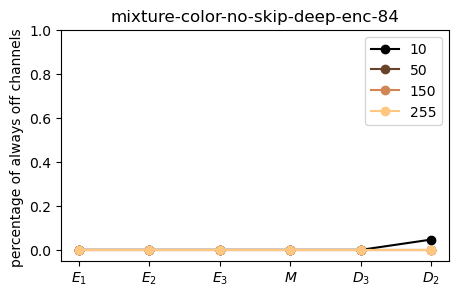

In [18]:
f, axs = plt.subplots(1, len(groups), figsize = ( len(groups)*5, 3) )
block_names = ['$E_1$','$E_2$' , '$E_3$', '$M$', '$D_3$','$D_2$']

j = 0
for group in groups:
    off_channels = {}
    for sig in sigmas:
        off_channels[sig] = []
        k1 = 0
        for l in layers[group]: 
            phi_block = torch.cat(a_bars[group][sig])[:,k1:k1 + l]
            off_channels[sig].append((phi_block.sum(dim = 0) == 0).sum().item())
            k1 += l  
            
    plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas ))]
    
    c = 0
    for sig in sigmas:    
        axs.plot(block_names, torch.tensor(off_channels[sig])/torch.tensor(layers[group]), '-o', color = plot_colors[c],  label = sig)
        c+= 1
    axs.set_ylabel('percentage of always off channels ');
    axs.set_ylim(-.05,1)
    axs.legend();
    axs.set_title(group);
    j += 1

#  Channel selectivity



In [22]:

phis = {}
for group in groups:
    phis[group] ={}
    for sig in sigmas:
        # print(sig)
        phis[group][sig] = [a_bars[group][sig][i][:, sum(layers[group][0:3]):sum(layers[group][0:4])] for i in range(len(a_bars[group][sig]))]
    print(phis[group][10][0].shape)

torch.Size([140, 512])


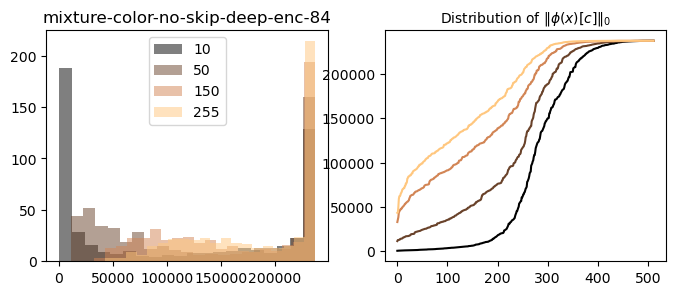

In [21]:
for group in groups:
    f, axs = plt.subplots(1,2, figsize = (8,3))
    i = 0
    for sig in sigmas:
        axs[0].hist(torch.cat(phis[group][sig]).norm(0, dim = 0).cpu(), alpha = .5, label = sig, bins = 20, color=plot_colors[i]);
        axs[1].plot(torch.cat(phis[group][sig]).norm(0, dim = 0).cpu().sort()[0], label = sig, color=plot_colors[i]);    
        axs[0].legend()
        i += 1
    axs[1].set_title('Distribution of $\Vert \phi(x)[c] \Vert_0$', fontsize = 10)   ;
    axs[0].set_title(group )   ;
    # print(group)    

The binary nature of the sparsity is interesting! There are some channels that are very selective. And some channels that are respond to all images. The around 100 channels that are in between 

The average $\phi$ per channel is small for most channels expect a handful. 

In [33]:
# ch_selectivity=torch.cat(phis[sig]).norm(1, dim = 0).cpu()**2 / torch.cat(phis[sig]).norm(2, dim = 0).cpu()**2/torch.cat(phis[sig]).shape[0]
ch_selectivity = {}
ids_selectivity_sorted = {}
for group in groups:
    ch_selectivity[group] = {}
    ids_selectivity_sorted[group] = {}
    for sig in sigmas:
        
        ch_selectivity[group][sig] = participation_ratio_dataset(torch.cat(phis[group][sig]).T.cpu())
        ch_selectivity[group][sig]= torch.nan_to_num(ch_selectivity[group][sig], nan=0.0)
        ids_selectivity_sorted[group][sig] = ch_selectivity[group][sig].sort(descending =True)[1]
        


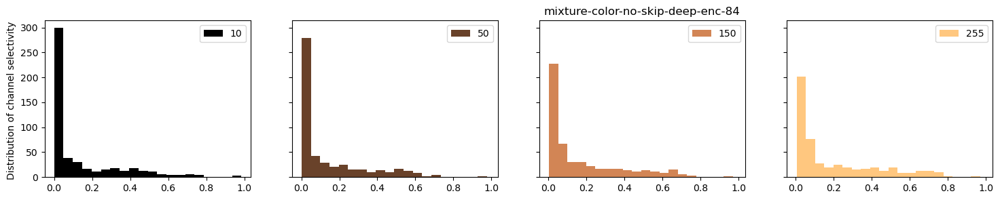

In [28]:
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(a_bars[group ].keys()))]

for group in groups:
    f, axs = plt.subplots(1,len(sigmas) , figsize = (18,3), sharey=True, sharex=True)
    i = 0 
    for sig in sigmas:
        axs[i].hist(ch_selectivity[group][sig], alpha = 1, label = sig, bins = 20, color = plot_colors[i]);   
        axs[i].legend()    
        i += 1
    axs[0].set_ylabel('Distribution of channel selectivity ')   ;
    axs[2].set_title(group )

        
    # print(group)

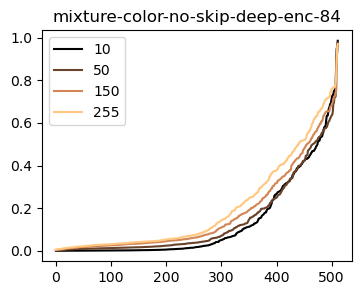

In [29]:
f, axs = plt.subplots(1,len(groups) , figsize = (4*len(groups),3), sharey=True, sharex=False)
c = 0
for group in groups:
    j = 0
    for sig in sigmas:
        axs.plot(ch_selectivity[group][sig].sort()[0], label = sig, color = plot_colors[j]);    
        
        j += 1
    axs.set_title(group)        
    c += 1
axs.legend();        
    

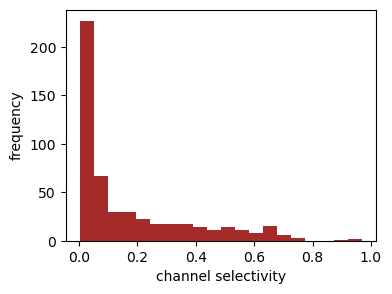

In [34]:
group = 'mixture-color-no-skip-deep-enc-84'
sig = 150
f, axs = plt.subplots(1,1 , figsize = (4,3), sharey=True, sharex=True)
axs.hist(ch_selectivity[group][sig], alpha = 1, label = sig, bins = 20, color = 'brown');   
axs.set_xlabel('channel selectivity')   ;
axs.set_ylabel('frequency')   ;
plt.savefig( '../results/ch_selectivity_texture_hist',bbox_inches='tight')    


## channel selectivity at other blocks

In [20]:
# other blocks 


ch_selectivity_all_scales = {}
for group in groups:
    ch_selectivity_all_scales[group] ={}
    for sig in sigmas:    
        ch_selectivity_all_scales[group][sig] = []
        k1 = 0
    
        for l in layers[group]: 
            phi_block = torch.cat(a_bars[group][sig])[:,k1:k1 + l]
            
            ch_selectivity_all_scales[group][sig].append(participation_ratio_dataset(phi_block.T).cpu())
            # ch_selectivity_all_scales[sig].append(torch.nan_to_num(participation_ratio_dataset(phi_block.T).cpu(), nan = 0.0))
            k1 += l     
            



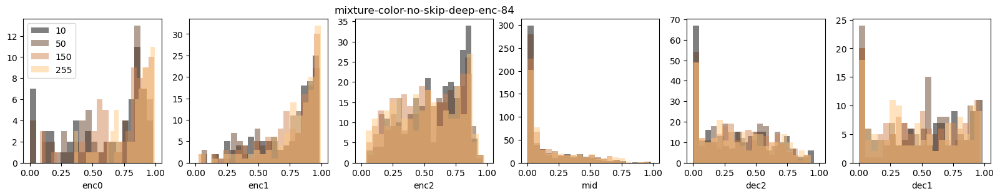

In [22]:
for group in groups:
    f, axs = plt.subplots(1 ,6, figsize = (20, 3))
    plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas))]
    
    for b in range(len(layers[group])):
        for i, sig in zip(range(len(sigmas)),sigmas):        
            axs[b].hist(ch_selectivity_all_scales[group][sig][b].flatten(), bins = 20, color= plot_colors[i] , alpha = .5, label = sig)
        axs[b].set_xlim(-.05, 1.05)
        axs[b].set_xlabel(block_names[group][b])
    axs[2].set_title(group)
    
    axs[0].legend();


# Specialized vs. Common channels

## Top images that activate a channel

channels selectivity:  0.9686737060546875


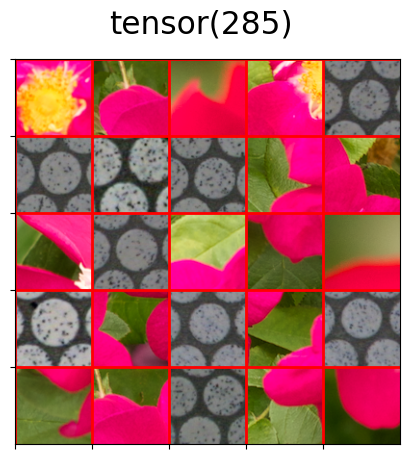

channels selectivity:  0.34803566336631775


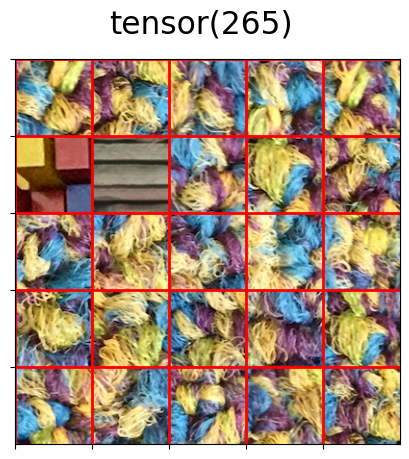

channels selectivity:  0.12455432862043381


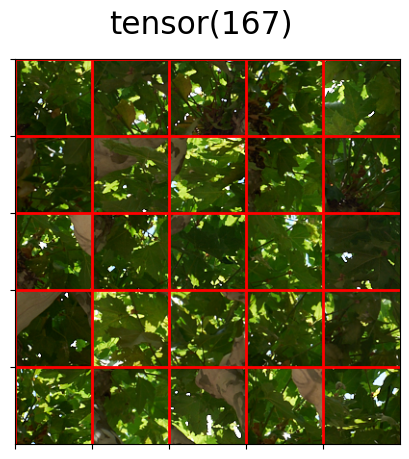

channels selectivity:  0.04825631156563759


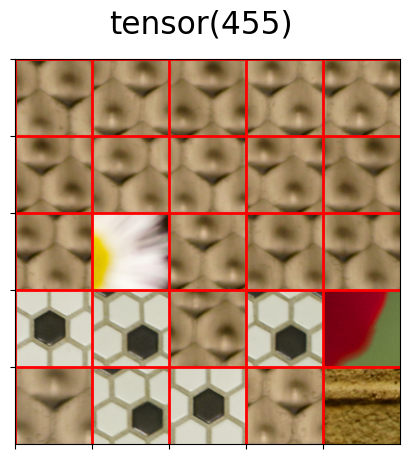

channels selectivity:  0.027341993525624275


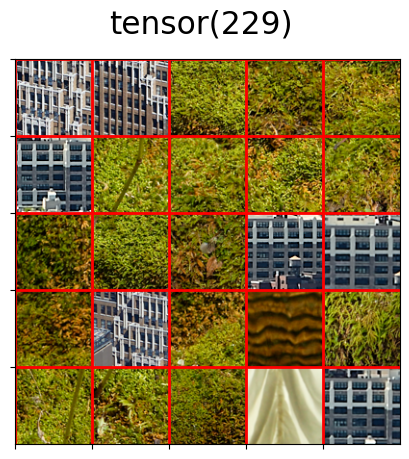

channels selectivity:  0.006973264738917351


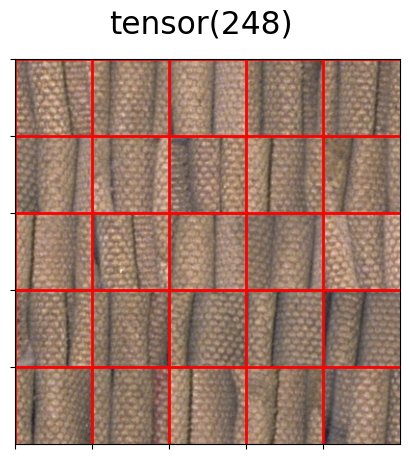

In [40]:
## channels shown in the paper: 313
sig = 150


for i in range(0, 510, 100):
    ch_n = ids_selectivity_sorted[group][sig][i]
    print('channels selectivity: ',  ch_selectivity[group][sig][ch_n].item()   )
    p = min(25, round(ch_selectivity[group][sig][ch_n].item() * train_sets_cat.shape[0]))

    show_im_grid(train_sets_cat[torch.cat(phis[group][sig])[:,ch_n].cpu().sort(descending = True)[1][0:p]], 
                 n_columns= 5 , im_size=1, grid_lines=True, label= ch_n)
    # show_im_grid(torch.cat(test_sets)[torch.cat(phis[50])[:,77].cpu().sort(descending = True)[1][0:25]], n_columns= 5 , im_size=1, return_image=False)
    # plt.savefig( '../results/channel77.png',bbox_inches='tight')  

channels selectivity:  1657


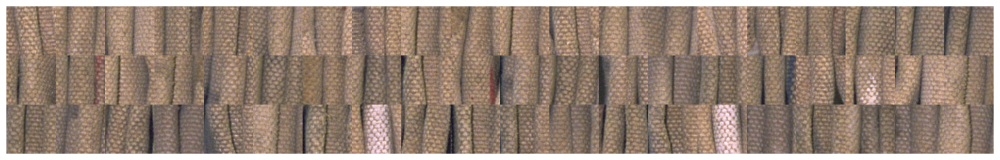

channels selectivity:  1618


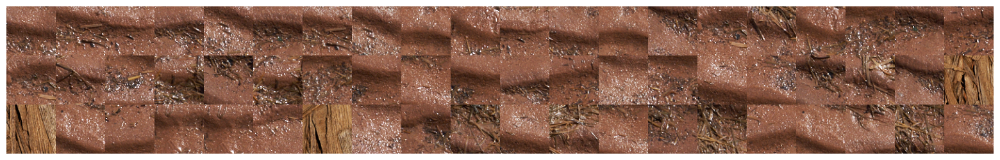

channels selectivity:  1534


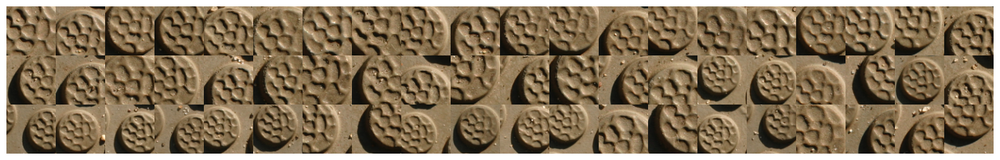

channels selectivity:  1460


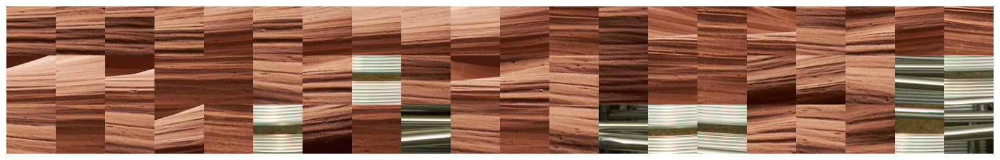

channels selectivity:  1457


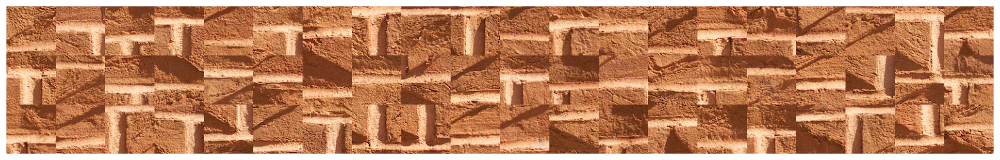

channels selectivity:  1454


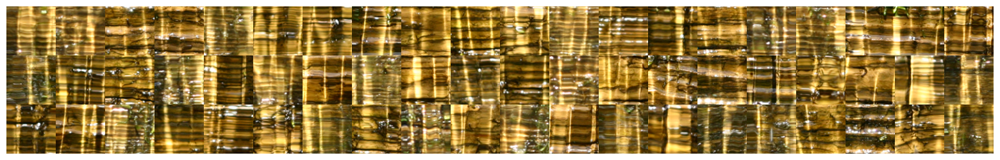

channels selectivity:  1221


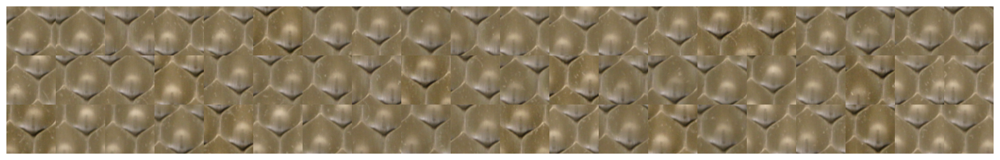

channels selectivity:  1208


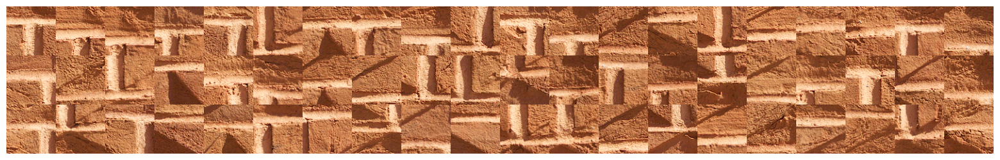

channels selectivity:  1203


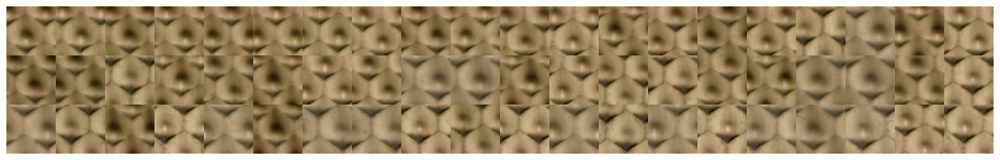

channels selectivity:  1047


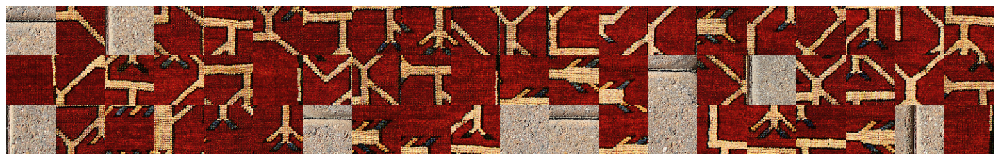

In [52]:
sig = 150


for i in range(500, 510):
    ch_n = ids_selectivity_sorted[group][sig][i]
    print('channels selectivity: ',  round(ch_selectivity[group][sig][ch_n].item() * train_sets_cat.shape[0] ) )

    p = min(60, round(ch_selectivity[group][sig][ch_n].item() * train_sets_cat.shape[0]))
    show_im_grid(train_sets_cat[torch.cat(phis[group][sig])[:,ch_n].cpu().sort(descending = True)[1][0:p]], 
                 n_columns= 20 , im_size=1)
    # show_im_grid(torch.cat(test_sets)[torch.cat(phis[50])[:,77].cpu().sort(descending = True)[1][0:25]], n_columns= 5 , im_size=1, return_image=False)
    # plt.savefig( '../results/channel77.png',bbox_inches='tight')  

## stability of channel selectivity over noise levels 

190
channels selectivity:  3480


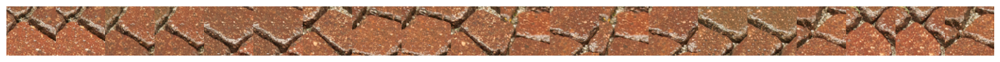

channels selectivity:  2638


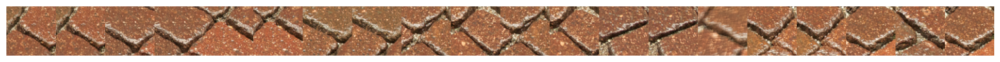

channels selectivity:  3264


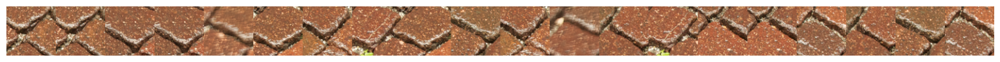

channels selectivity:  4989


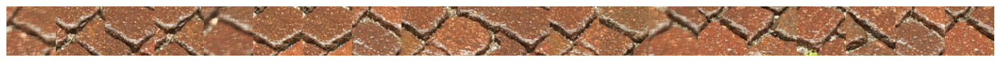

In [36]:
ch_n = torch.randint(0, layers[group][3], size = (1,)).item()
print(ch_n)
for sig in sigmas:    
    p = min(20, round(ch_selectivity[group][sig][ch_n].item() * train_sets_cat.shape[0]))    
    if p ==0: 
        p = 1
    print('channels selectivity: ',  round(ch_selectivity[group][sig][ch_n].item() * train_sets_cat.shape[0]))

    show_im_grid(train_sets_cat[torch.cat(phis[group][sig])[:,ch_n].cpu().sort(descending = True)[1][0:p]], 
                 n_columns= 20 , im_size=1)
    # show_im_grid(torch.cat(test_sets)[torch.cat(phis[50])[:,77].cpu().sort(descending = True)[1][0:25]], n_columns= 5 , im_size=1, return_image=False)
    # plt.savefig( '../results/channel77.png',bbox_inches='tight')    


## Distribution of $\phi$ within each channel 
common channels are Gaussian. Specialized channels are not 

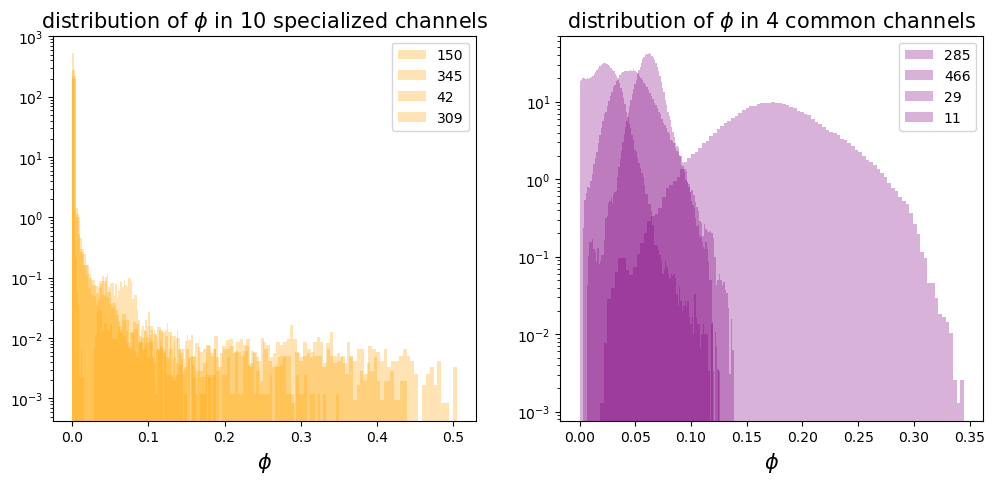

In [38]:
sig = 150 
f, axs = plt.subplots(1,2, figsize = (12,5), sharex= False, sharey = False)

for id in ids_selectivity_sorted[group][sig][-4::]: 
    axs[0].hist(   torch.cat(phis[group][sig]).cpu()[:, id ], bins = 100, alpha = .3 , density = True, color = 'orange', label = id) ;
axs[0].set_title('distribution of $\phi$ in 10 specialized channels',fontsize = 15 )

for id in ids_selectivity_sorted[group][sig][0:4]: 
    axs[1].hist(   torch.cat(phis[group][sig]).cpu()[:, id ], bins = 100, alpha = .3 , density = True, color = 'purple', label = id) ;
axs[1].set_title('distribution of $\phi$ in 4 common channels' ,fontsize = 15)
axs[0].legend()
axs[1].legend();
axs[0].set_xlabel('$\phi$',fontsize = 15)
axs[1].set_xlabel('$\phi$',fontsize = 15)

axs[0].set_yscale('log')
axs[1].set_yscale('log')


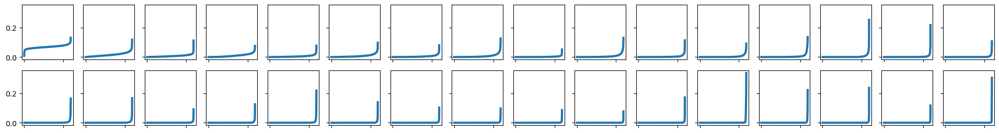

In [40]:
sig = 50
f, axs = plt.subplots(2,16, figsize = (16 * 1.5, 2* 1.5), sharex = True, sharey = True)
axs = axs.ravel()
for i in range(32) : 
    axs[i].plot(torch.cat(phis[group][sig]).cpu()[:,ids_selectivity_sorted[group][sig]][:,i * 16].sort()[0] , lw = 3)
    axs[i].set_xticklabels([])
# plt.savefig('../results/channel_activations_sorted.pdf',bbox_inches='tight')    


## Joint distribution of common channels and specialized channels 

Text(0.5, 1.0, 'joint density b/w two common channels')

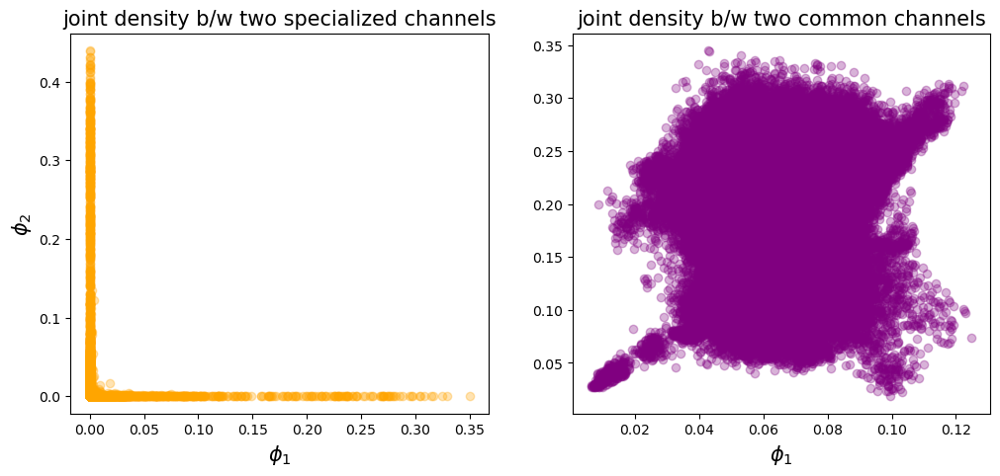

In [41]:
sig = 150 
f, axs = plt.subplots(1,2, figsize = (12,5), sharex= False, sharey = False)

axs[0].scatter(torch.cat(phis[group][sig]).cpu()[:, ids_selectivity_sorted[group][sig][-1::] ],
               torch.cat(phis[group][sig]).cpu()[:, ids_selectivity_sorted[group][sig][-2:-1] ], 
               alpha = .3 ,  label = id ,color = 'orange') ;

axs[1].scatter(torch.cat(phis[group][sig]).cpu()[:, ids_selectivity_sorted[group][sig][0:1] ],
               torch.cat(phis[group][sig]).cpu()[:, ids_selectivity_sorted[group][sig][1:2] ], 
               alpha = .3 ,  label = id,  color = 'purple' );
axs[0].set_xlabel('$\phi_1$', fontsize = 15)
axs[1].set_xlabel('$\phi_1$', fontsize = 15)
axs[0].set_ylabel('$\phi_2$', fontsize = 15)
axs[0].set_title('joint density b/w two specialized channels', fontsize = 15)
axs[1].set_title('joint density b/w two common channels', fontsize = 15)


## Common channels are also spatially denser (capture lower frequencies)
Generally, spatial sparsity is even lower than channel sparsity

torch.Size([1697, 512, 10, 10])
torch.Size([1697, 512, 10, 10])
torch.Size([1697, 512, 10, 10])
torch.Size([1697, 512, 10, 10])


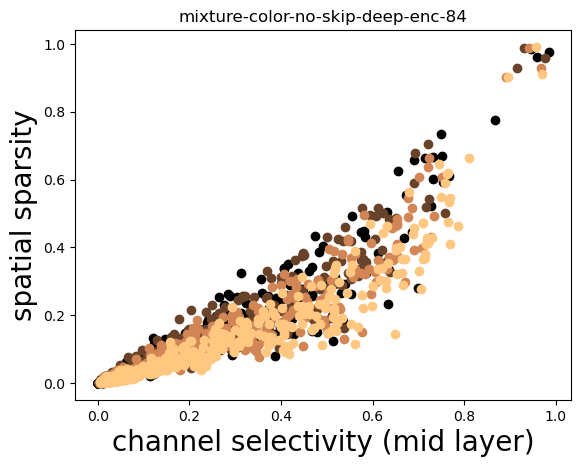

In [42]:
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas) )]
i = 0
for sig in sigmas:
    clean_inp = torch.cat([train_sets[k][0:1] for k in range(len(train_sets))]) 
    # clean_inp = test_sets[0]
    
    noisy_inp =clean_inp + torch.randn_like(clean_inp) * sig/255
    # _ , acts = get_channel_means(denoisers[group], noisy_inp, return_activations=True )
    
    acts = get_activations_unconditional(denoisers[group], noisy_inp, noGrad=True)
    print(acts[3].shape)
    # spatial sparsity 
    spatial_sparsity = []
    for c in range(layers[group][3]):
        spatial_sparsity.append(torch.nan_to_num(participation_ratio_dataset(acts[3][:,c].flatten(start_dim = 1)), nan=0).mean())
    
    
    plt.scatter(  ch_selectivity[group][sig] , torch.stack(spatial_sparsity).flatten().cpu() , color = plot_colors[i]) 
    i += 1
    plt.title(group)
plt.xlabel('channel selectivity (mid layer)', fontsize = 20 )
plt.ylabel('spatial sparsity', fontsize = 20);


## PCA of channel responses
specializd channels are more concentrated \
common channels are higher dimensional 

In [43]:
from sklearn.decomposition import PCA


In [44]:

sig = 150

clean_inp = torch.cat([train_sets[k][0:1] for k in range(len(train_sets))]) 

noisy_inp =clean_inp + torch.randn_like(clean_inp) * sig/255
# _ , acts = get_channel_means(denoisers[group], noisy_inp, return_activations=True )

acts = get_activations_unconditional(denoisers[group], noisy_inp, noGrad=True)

In [45]:
# Create pca model

pca_model = PCA(n_components=64)
# Fit model
PC = []
exp_var = []
for i in range(layers[group][3]):
    PC.append(torch.tensor(pca_model.fit_transform(acts[3][:, i].flatten(start_dim = 1).cpu().T )) )
    exp_var.append(torch.tensor(pca_model.explained_variance_ratio_) )
PC = torch.stack(PC).unsqueeze(1)


In [46]:
PC.shape

torch.Size([512, 1, 100, 64])

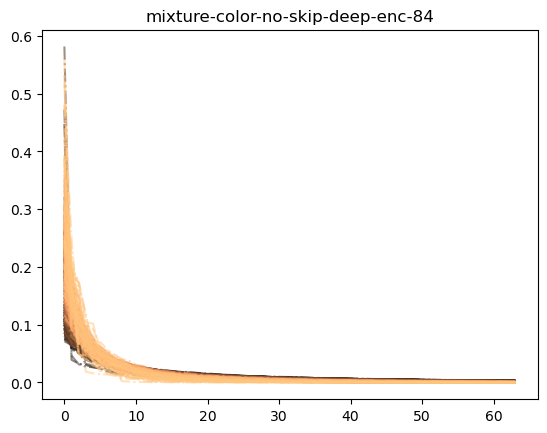

In [47]:
colormap = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors = [colormap(i) for i in np.linspace(0, 1,layers[group][3])]

for i in range(layers[group][3]):
    plt.plot(torch.stack(exp_var)[ids_selectivity_sorted[group][150]][i,:], '-.',color = plot_colors[i], alpha = .5)
plt.title(group);

Text(0, 0.5, 'cumulative explained variance')

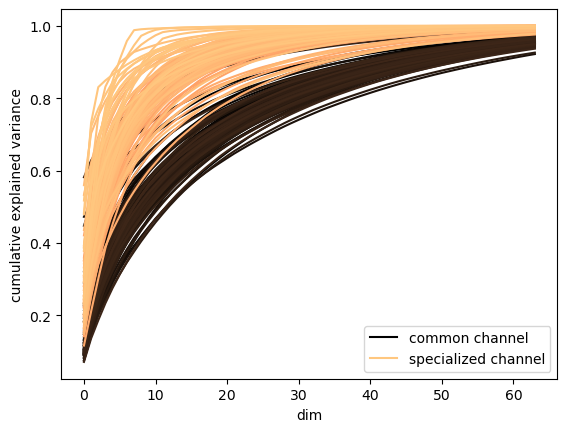

In [49]:
### 
colormap = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors = [colormap(i) for i in np.linspace(0, 1,512)]

plt.plot(torch.cumsum(torch.stack(exp_var)[ids_selectivity_sorted[group][sig]], dim = 1)[0,:] , color = plot_colors[0], label = 'common channel' ) 

for i in range(1,100):
    plt.plot(torch.cumsum(torch.stack(exp_var)[ids_selectivity_sorted[group][sig]], dim = 1)[i,:] , color = plot_colors[i] ) 

for i in range(-100,-1):
    plt.plot(torch.cumsum(torch.stack(exp_var)[ids_selectivity_sorted[group][sig]], dim = 1)[i,:] , color = plot_colors[i] ) 

plt.plot(torch.cumsum(torch.stack(exp_var)[ids_selectivity_sorted[group][sig]], dim = 1)[-1,:] , color = plot_colors[-1], label = 'specialized channel' ) 

plt.legend()
plt.xlabel('dim')
plt.ylabel('cumulative explained variance')

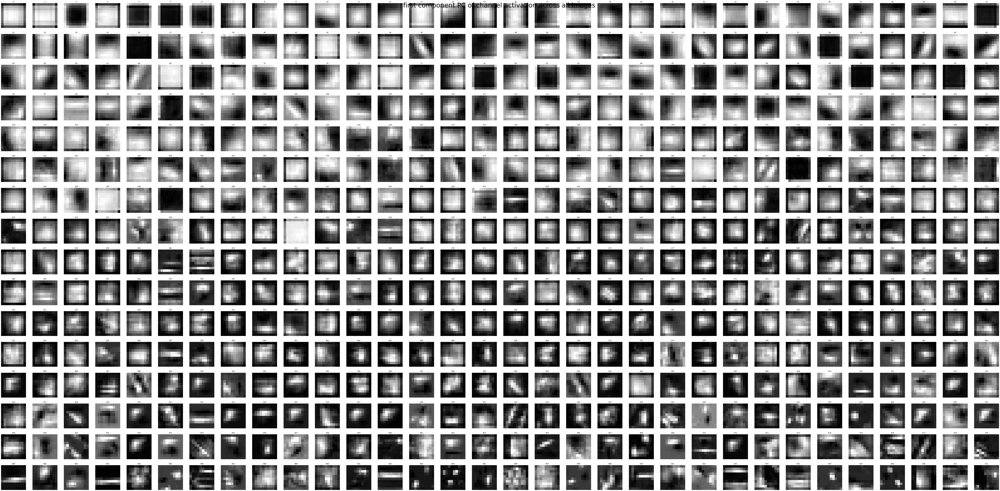

150


In [51]:
show_im_set(PC[:,:,:,0:1].reshape(512,1,10,10)[ids_selectivity_sorted[group][sig]], n_columns=32 , 
             label= 'first component PC of channel activation across all images', font_size=30)
print(sig)

## Common vs specialzied channels are different in their noise resistance 
common channels grow linearly with noise, and specialized channels go up and come down 

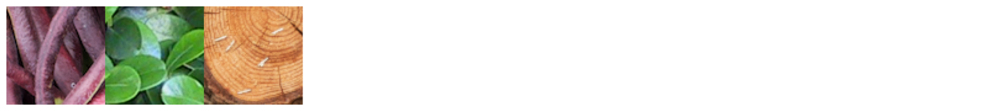

In [82]:
## for many images 


ids = torch.randint(0,len(my_ims), (3,))
inp_ims = my_ims[ids]
noise = torch.randn_like(inp_ims)

plot_colors = [scale_colormap(i) for i in np.linspace(0, 1,len(inp_ims))]

if 'gray' in group.split('-'): 
    inp_ims = inp_ims.mean(dim = 1, keepdim = True)

mysigmas= range(0,256, 10)

all_phis  = {}

for sig in mysigmas: 
    inp_ims_noisy = inp_ims + noise * (sig/255) 
    phi_xc = get_activation_means_unconditional(denoisers[group], inp_ims_noisy)
    all_phis[sig] = phi_xc


temp = torch.stack([all_phis[sig][3].squeeze() for sig in mysigmas]).cpu()
show_im_grid(inp_ims)

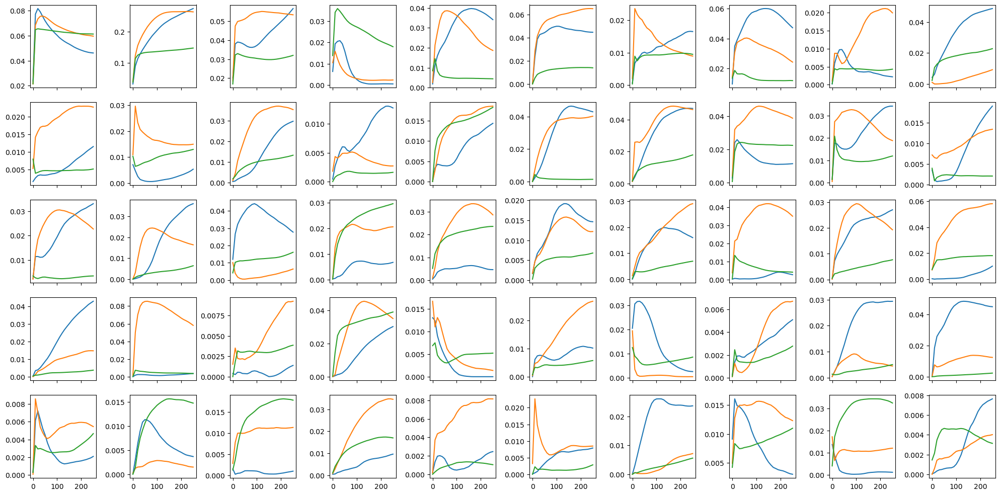

In [21]:
sig = 50
f, axs = plt.subplots(5,10, figsize = (20,10), sharey = False, sharex=True)
plt.tight_layout()

axs = axs.ravel()
for i in range(np.prod(axs.shape)):
    ch = i 
    for im in range(temp.shape[1]):
        axs[i].plot(mysigmas, temp[:,im, :][:,ids_selectivity_sorted[group][sig] ][:,ch] )



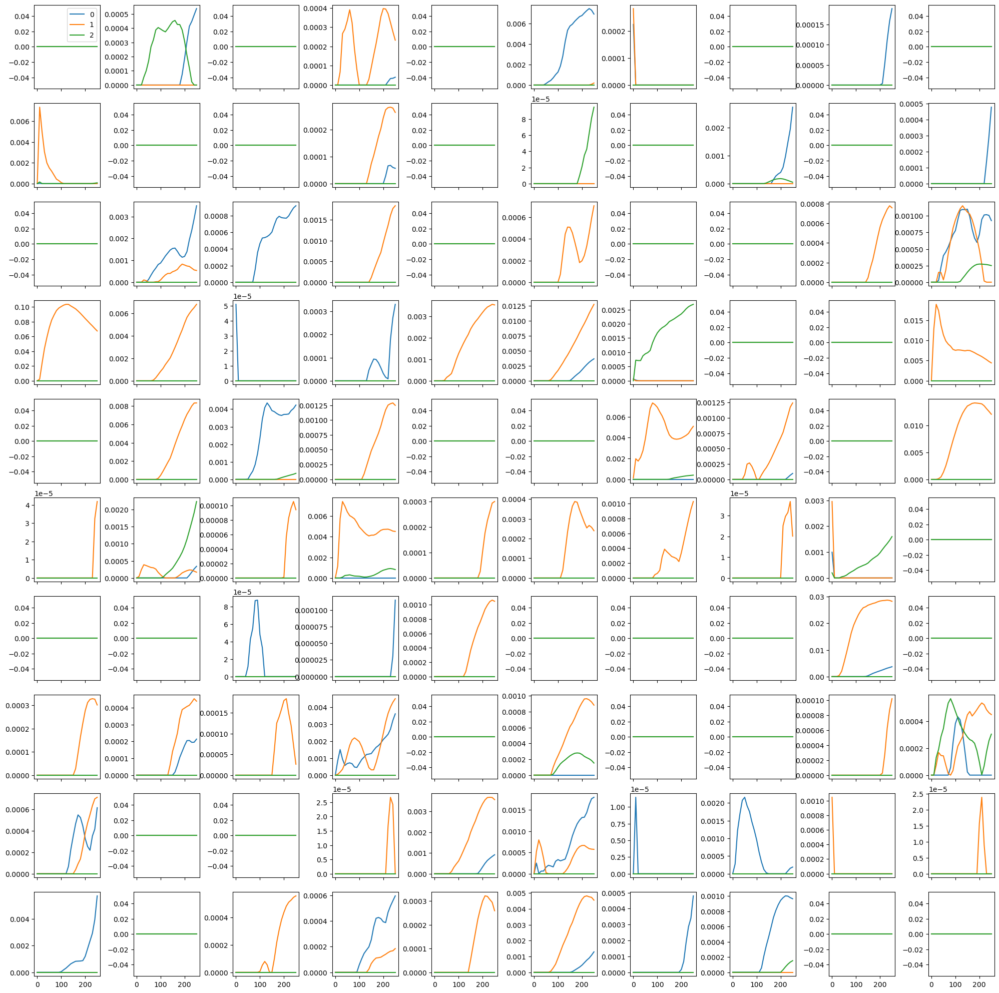

In [22]:

f, axs = plt.subplots(10,10, figsize = (20,20), sharey = False, sharex=True)
plt.tight_layout()
axs = axs.ravel()
for i in range(np.prod(axs.shape)):
    ch = 511 - i
    for im in range(temp.shape[1]):
        axs[i].plot(mysigmas, temp[:,im, :][:,ids_selectivity_sorted[group][sig] ][:,ch], label = im)

axs[0].legend();

## activations in individual channels 

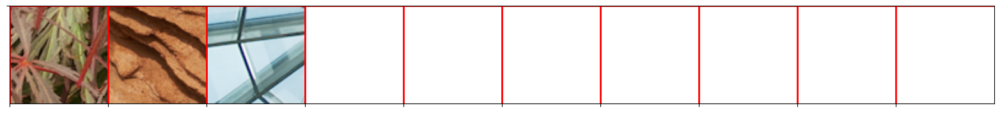

In [48]:
sig = 150
noise = torch.randn_like(inp_ims[0:1])
noisy_inp = inp_ims + torch.tile(noise, dims = (inp_ims.shape[0],1,1,1) ) * sig/255
acts  = get_activations_unconditional(denoisers[group], noisy_inp)



show_im_grid(inp_ims.cpu() , grid_lines=True)

In [49]:
acts[3].cpu()[:,ids_selectivity_sorted[group][sig]][:, ch_n:ch_n+ 1].shape

torch.Size([3, 1, 10, 10])

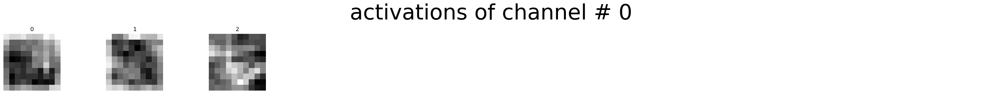

tensor(0.3761)

In [51]:
ch_n = 0
show_im_set(acts[3].cpu()[:,ids_selectivity_sorted[group][sig]][:, ch_n:ch_n+ 1].cpu() ,
            label= 'activations of channel # ' +str(ch_n), font_size=30)
ch_selectivity[group][sig][ch_n]

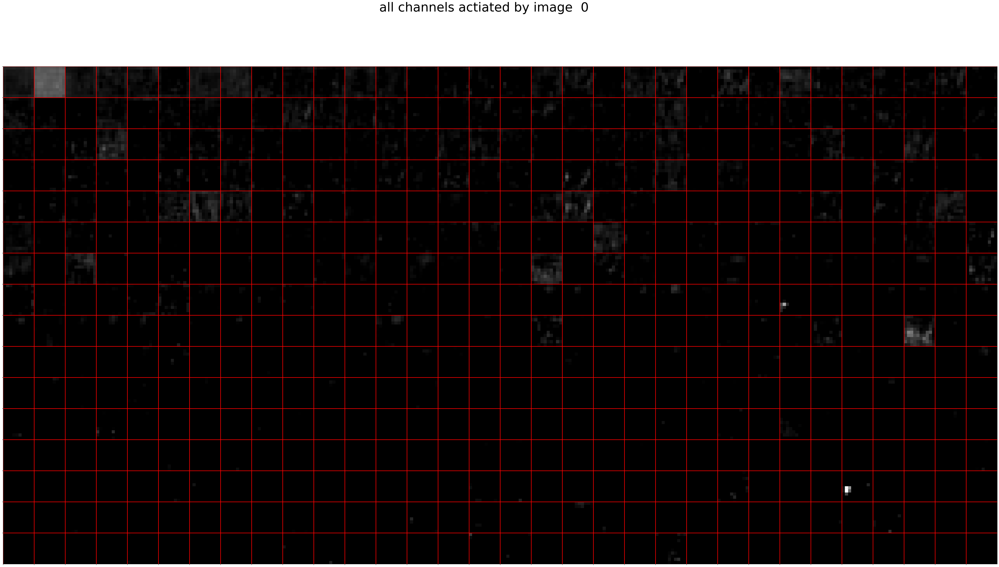

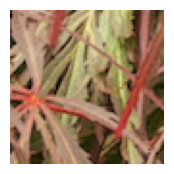

In [52]:
# im_n = 60
im_n = 0
# im_n = 59

show_im_grid(acts[3][im_n ].unsqueeze(1).cpu()[ids_selectivity_sorted[group][sig]], n_columns=32, grid_lines=True , 
             label= 'all channels actiated by image  ' +str(im_n), font_size=30)
plot_single_im(inp_ims[im_n])

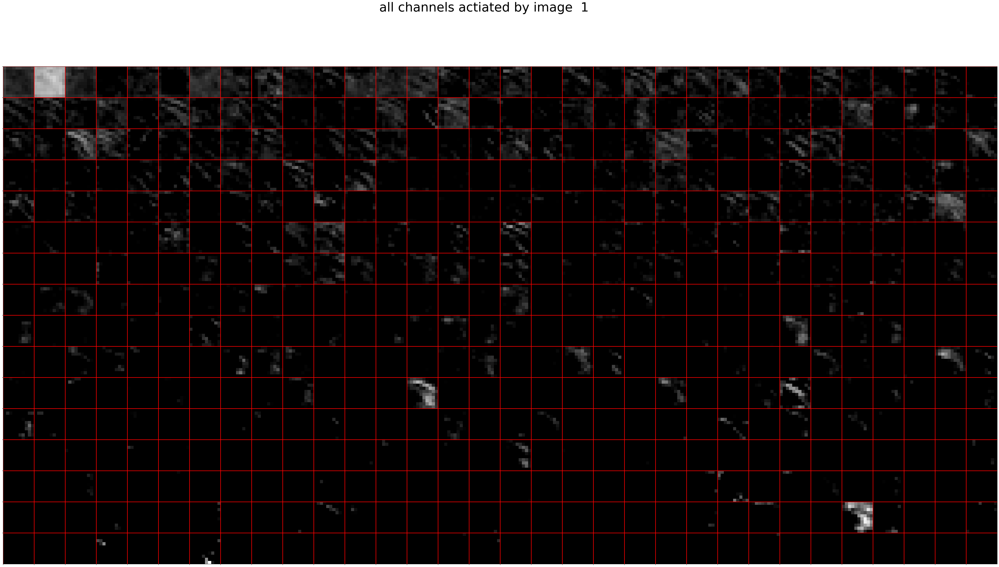

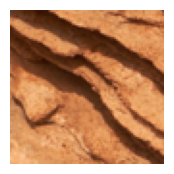

In [53]:
im_n = 1
# im_n = 67
# im_n = 59

show_im_grid(acts[3][im_n ].unsqueeze(1).cpu()[ids_selectivity_sorted[group][sig]], n_columns=32, grid_lines=True , 
             label= 'all channels actiated by image  ' +str(im_n), font_size=30)
plot_single_im(inp_ims[im_n])

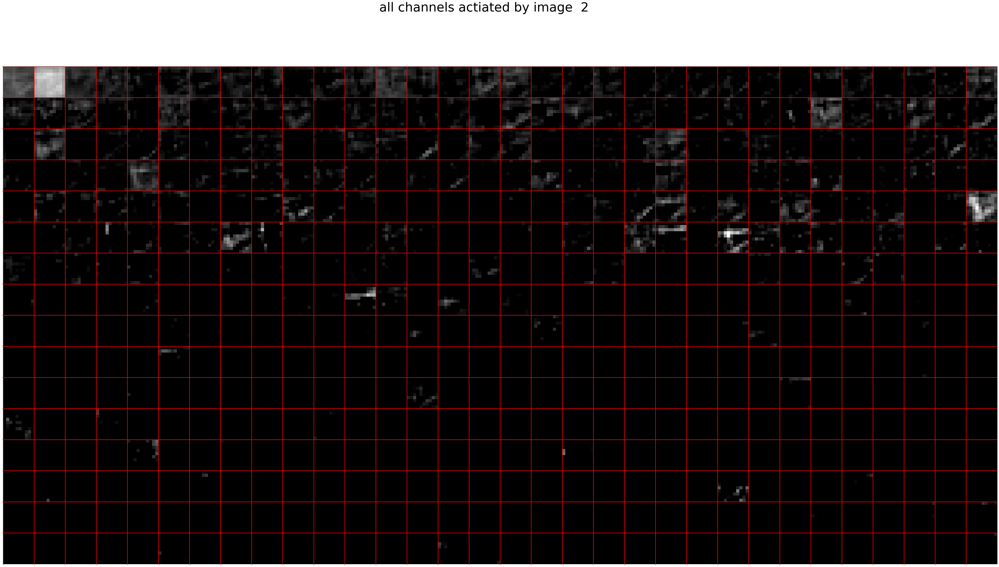

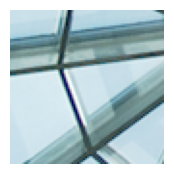

In [54]:
# im_n = 60
im_n = 2
# im_n = 59

show_im_grid(acts[3][im_n ].unsqueeze(1).cpu()[ids_selectivity_sorted[group][sig]], n_columns=32, grid_lines=True , 
             label= 'all channels actiated by image  ' +str(im_n), font_size=30)
plot_single_im(inp_ims[im_n])

## How does PR change with noise level? 
PR is stable across noise levels, but not for small noise 

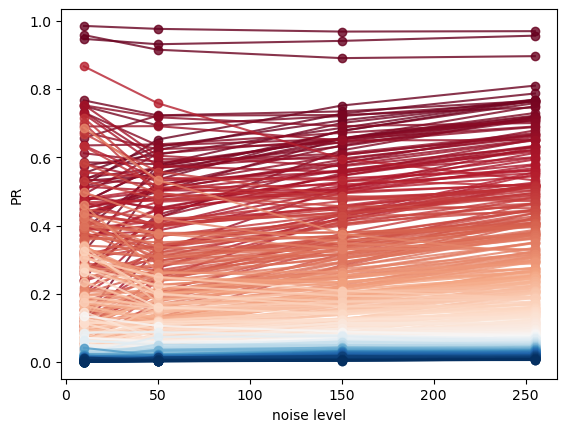

In [25]:
colormap = plt.cm.RdBu  
plot_colors = [colormap(i) for i in np.linspace(0, 1,layers[group][3] )]
i = 0
for id in ids_selectivity_sorted[group][255][0:layers[group][3]]:
    
    temp = torch.stack([ch_selectivity[group][sig][id] for sig in sigmas ])
    plt.plot(sigmas, temp, '-o', color = plot_colors[i] , alpha = .8)
    i += 1
# for id in ids_selectivity_sorted[255][-300:]:
#     temp = torch.stack([ch_selectivity[sig][id] for sig in [ 0, 10, 50,150,255] ])
#     plt.plot([ 0, 10, 50,150,255], temp, '-o', color = plot_colors[i], alpha = .5 )
#     i += 1
plt.ylabel('PR')
plt.xlabel('noise level');

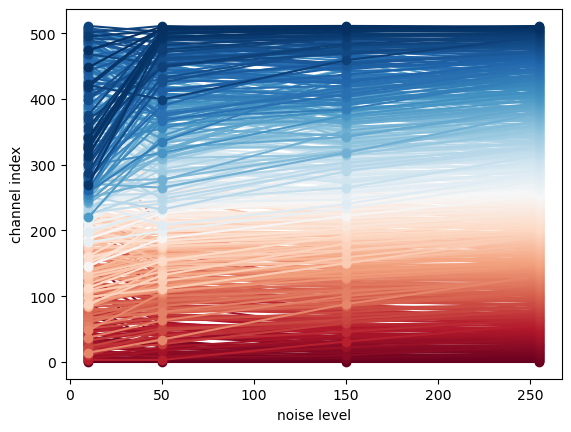

In [28]:
plot_colors = [colormap(i) for i in np.linspace(0, 1,layers[group][3])]
i = 0
for id in ids_selectivity_sorted[group][255][0:layers[group][3]]:
    temp = torch.cat([torch.nonzero(ids_selectivity_sorted[group][sig] == id, as_tuple=False) for sig in sigmas ])
    plt.plot(sigmas, temp, '-o', color = plot_colors[i] )
    i += 1
# for id in ids_selectivity_sorted[255][-200:]:
#     temp = torch.cat([torch.nonzero(ids_selectivity_sorted[group][sig] == id, as_tuple=False) for sig in [ 0, 10, 50,150,255] ])
#     plt.plot([ 0, 10, 50,150,255], temp, '-o', color = plot_colors[i] )
#     i += 1
plt.xlabel('noise level');
plt.ylabel('channel index');